In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import os
from owi_data_2_pandas.io import API
import datetime
from pytz import utc
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
import numpy as np
import matplotlib.dates as mdates
# sklearn imports
from sklearn.model_selection import train_test_split

# oma_tracking imports
from oma_tracking.data.preprocessing import sin_cos_angle_inputs

# Import vub Meetenet Vlaamse Banken API functions
from vubmvbc.config import Credentials
from vubmvbc.client import Base
from vubmvbc.objects import Catalog, Data
import vubmvbc.data_getter as dg

from oma_tracking.oma_clustering import ModeClusterer  #pip install hdbscan --no-build-isolation --no-binary :all
from oma_tracking.data.make_dataset import DatasetGetter
from oma_tracking.data.utils import unpack_mode, get_frequencies, get_rated_data, get_parked_data, read_simulations_csv_files

In [3]:
start  = datetime.datetime(2012,1,1,tzinfo=utc)
stop  = datetime.datetime(2023,7,19,tzinfo=utc)

location = 'bbc01'
name_location = 'BB_C01'

home_folder = "../../"
data_file_name = '_'.join([location, start.strftime("%Y%m%d"), stop.strftime("%Y%m%d")])
data_path = home_folder + "data/bb/raw/" + data_file_name + ".parquet"
data = pd.read_parquet(data_path)


SS1 = get_frequencies(data, 'SS1')
SS2 = get_frequencies(data, 'SS2')
FA1 = get_frequencies(data, 'FA1')

In [4]:
weather_data_path = "../../data/nw2/mvbc_data_longterm.parquet"
Thorntonbank_data_path = "../../data/nw2/Thorntonbank_data_longterm.parquet"
Westhinder_data_path = "../../data/nw2/Westhinder_data_longterm.parquet"

weather_data = pd.read_parquet(weather_data_path)

scada_inputs = data.filter(regex='mean')

inputs = \
    pd.concat(
        [
            weather_data,
            scada_inputs
        ],
        axis=1
    )

selected_columns = \
    [
       #'mvbc_WandelaarBuoy_10%_highest_waves',
       #'mvbc_WandelaarBuoy_Wave_height',
       #'mvbc_WandelaarBuoy_Average_wave_period',
       #'mvbc_WandelaarMeasuringpile_Tide_TAW',
       #'mvbc_WandelaarMeasuringpile_Air_pressure',
       #'mvbc_WandelaarMeasuringpile_Air_temperature',
       #'mvbc_Wandelaar_Sea_water_temperature',
       'Sea_water_temperature',
       'Wave_height',
       'Tide_TAW',
       'Average_wave_period',
       'mean_'+ name_location + '_rpm',
       'mean_'+ name_location + '_yaw',
       'mean_'+ name_location + '_pitch',
       'mean_'+ name_location + '_power',
       'mean_'+ name_location + '_windspeed',
       'mean_'+ name_location + '_winddirection'
    ]
inputs = inputs[selected_columns]

In [5]:
random_state = 24
test_size = 0.8

angle_transformed_inputs = sin_cos_angle_inputs(inputs)
angle_columns = [angle for angle in inputs.columns if ('yaw' in angle or 'winddirection' in angle)]
angle_removed_inputs = inputs.drop(columns=angle_columns)

prediction_param = SS1.copy()
y = prediction_param.dropna()
X = angle_transformed_inputs.loc[y.index].dropna()
y = y.loc[X.index]
X_train, X_test, y_train, y_test = \
train_test_split(X, y, test_size=test_size, shuffle=False)

from sklearn.preprocessing import StandardScaler
def data_preprocessing(X_train, X_test):
    "Apply standard scaling to the data"
    scaler = StandardScaler()
    X_train = pd.DataFrame(scaler.fit_transform(X_train), columns=X_train.columns, index=X_train.index)
    X_test = pd.DataFrame(scaler.transform(X_test), columns=X_test.columns, index=X_test.index)
    return X_train, X_test
    
X_tr_prep, X_test_prep = data_preprocessing(X_train, X_test) 

In [6]:
import numpy as np
from xgboost import XGBRegressor
from oma_tracking.models.virtual_ensemble import VirtualEnsembleXGB

# Example usage
n_estimators = 50

xgb_model = XGBRegressor(n_estimators=n_estimators)
xgb_model.fit(X_train, y_train)

n_submodels = int(n_estimators/2)
ensemble_model = VirtualEnsembleXGB(xgb_model, n_submodels)
predictions = ensemble_model.predict(X)
mean_predictions = ensemble_model.mean_predictions(X)
std_predictions = ensemble_model.std_predictions(X)

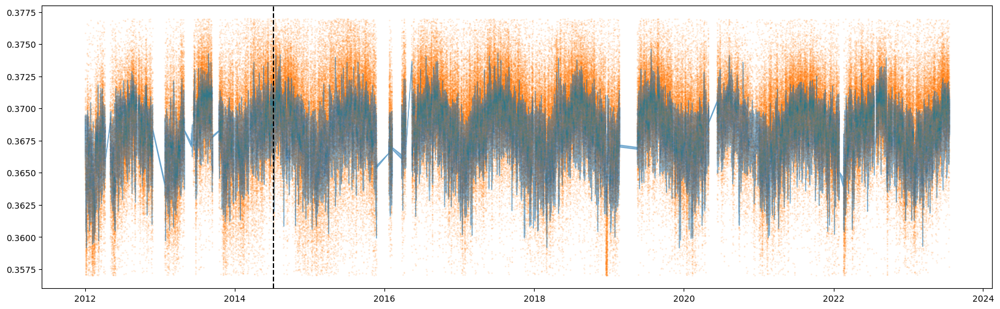

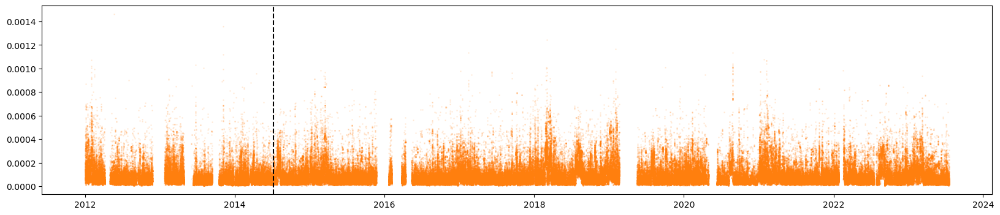

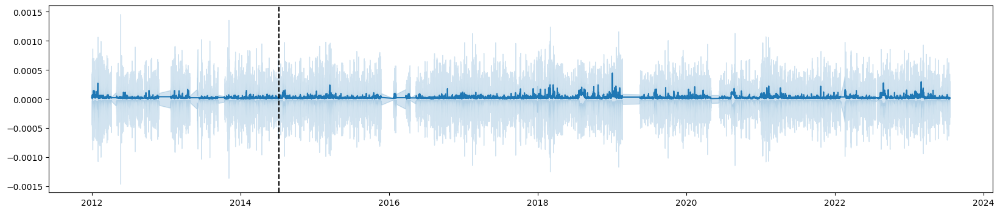

In [7]:
import matplotlib.pyplot as plt

plt.figure(figsize=(20,6))
plt.scatter(y.index, y, alpha=0.1, color='tab:orange', s=1)
plt.scatter(y.index, mean_predictions, alpha=0.01, s=1)
plt.fill_between(y.index, mean_predictions-std_predictions, mean_predictions+std_predictions, alpha = 0.5, color = 'tab:blue')
plt.axvline(x=X_test.index[0], color='k', linestyle='--')
plt.show()

plt.figure(figsize=(20,4))
plt.scatter(y.index, std_predictions, alpha=0.1, color='tab:orange', s=1)
plt.axvline(x=X_test.index[0], color='k', linestyle='--')
plt.show()

plt.figure(figsize=(20,4))
#plt.scatter(range(len(y.iloc[12000:])), y.iloc[12000:], alpha=0.1, color='tab:orange')
#plt.scatter(range(len(mean_predictions)), mean_predictions, alpha=0.2)
plt.fill_between(y.index, -std_predictions, +std_predictions, alpha = 0.2, color = 'tab:blue')
plt.plot(y.index, pd.DataFrame(std_predictions).rolling(int(144/2)).min())
plt.axvline(x=X_test.index[0], color='k', linestyle='--')

plt.show()

C:\Users\Max\AppData\Local\Temp\ipykernel_33556\4283219116.py:11: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  ax1 = plt.subplot(grid[0])
c:\Users\Max\anaconda3\envs\soiltwin\lib\site-packages\seaborn\distributions.py:1689: FutureWarning: The `vertical` parameter is deprecated and will be removed in a future version. Assign the data to the `y` variable instead.
  warnings.warn(msg, FutureWarning)
c:\Users\Max\anaconda3\envs\soiltwin\lib\site-packages\seaborn\distributions.py:1689: FutureWarning: The `vertical` parameter is deprecated and will be removed in a future version. Assign the data to the `y` variable instead.
  warnings.warn(msg, FutureWarning)
c:\Users\Max\anaconda3\envs\soiltwin\lib\site-packages\seaborn\distributions.py:1689: FutureWarning: The `vertical` parameter is deprecated and will be removed in a future version. Assign the data to the `y` v

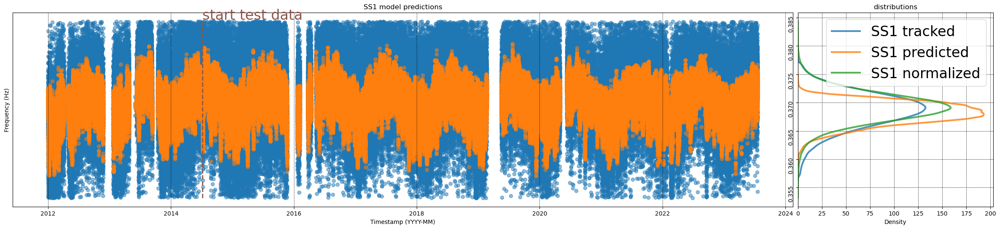

In [8]:
import numpy as np 
import matplotlib.gridspec as gridspec
import seaborn as sns
end_training = X_train.index[-1]
end_test = X_test.index[-1]
mode = 'SS1'

# Create a grid of subplots
fig, axs = plt.subplots(1, 2, figsize=(30, 6))
grid = gridspec.GridSpec(1, 2, width_ratios=[8, 2])
ax1 = plt.subplot(grid[0])
ax1.scatter(y.index, y, label = 'SS1 tracked', alpha = 0.5)
ax1.scatter(y.index, mean_predictions, label = 'SS1 predicted', alpha=0.5)
ax1.set_ylabel('Frequency (Hz)')
ax1.set_xlabel('Timestamp (YYYY-MM)')
ax1.set_title(mode + ' model predictions')
ax1.set_yticks([])
ax1.grid(True, color='k', linestyle='--', linewidth=0.5)
ax1.vlines(end_training, y.min(), y.max(), color='tab:brown', linestyle='--', linewidth=2)
ax1.text(end_training, y.max()+0.0002, 'start test data', color='tab:brown', rotation=0, fontsize=24)

ax2 = plt.subplot(grid[1])
ax2.set_title('distributions')
sns.kdeplot(y.values[:,0], label='SS1 tracked', ax=ax2, alpha=0.8, vertical=True, linewidth=3)
sns.kdeplot(mean_predictions, label='SS1 predicted', ax=ax2, alpha=0.8, vertical=True, linewidth=3)
normalized = (y.values[:,0]-mean_predictions) + np.mean(y.values[:,0])
sns.kdeplot(normalized, label='SS1 normalized', ax=ax2, alpha=0.8, vertical=True, linewidth=3)

# Rotate the y-axis labels of the KDE plot
for tick in ax2.get_yticklabels():
    tick.set_rotation(90)

#ax2.hist(tracked_frequencies[mode].values, density=False, label='SS1 tracked', bins=1000, orientation='horizontal', alpha=0.8, histtype='stepfilled')
#ax2.hist(predictions[mode].values, density=False, label='SS1 predicted', bins=1000, orientation='horizontal', alpha=0.8, histtype='stepfilled')
#ax2.hist(normalized[mode].values, density=False, label='SS1 normalized', bins=1000, orientation='horizontal', alpha=0.8, histtype='stepfilled')

ax2.grid(True, color='k', linestyle='--', linewidth=0.5)
# Adjust the spacing between subplots
plt.subplots_adjust(wspace=0.01)
legend = plt.legend()
legend.set_alpha(1.0)  # Remove alpha from the legend
# Remove alpha from the legend items
for text in legend.get_texts():
    text.set_alpha(1.0)
plt.legend(fontsize=24)
plt.show()

C:\Users\Max\AppData\Local\Temp\ipykernel_33556\3608883823.py:6: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  ax1 = plt.subplot(grid[0])
c:\Users\Max\anaconda3\envs\soiltwin\lib\site-packages\seaborn\distributions.py:1689: FutureWarning: The `vertical` parameter is deprecated and will be removed in a future version. Assign the data to the `y` variable instead.
  warnings.warn(msg, FutureWarning)


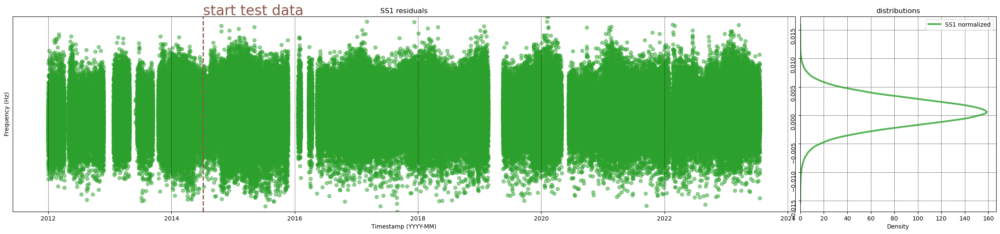

In [9]:
residuals = pd.Series(y.values[:,0] - mean_predictions, index=y.index)

# Create a grid of subplots
fig, axs = plt.subplots(1, 2, figsize=(30, 6))
grid = gridspec.GridSpec(1, 2, width_ratios=[8, 2])
ax1 = plt.subplot(grid[0])
ax1.scatter(residuals.index, residuals, label = 'SS1 residuals', alpha=0.5, c='tab:green')

ax1.set_ylabel('Frequency (Hz)')
ax1.set_title(mode + ' residuals')
ax1.set_yticks([])
ax1.grid(True, color='k', linestyle='--', linewidth=0.5)
ax1.vlines(end_training, residuals.min(), residuals.max(), color='tab:brown', linestyle='--', linewidth=2)
ax1.text(end_training, residuals.max()+0.0002, 'start test data', color='tab:brown', rotation=0, fontsize=24)
ax1.set_ylim(residuals.min(), residuals.max())
ax1.set_xlabel('Timestamp (YYYY-MM)')

ax2 = plt.subplot(grid[1])
ax2.set_title('distributions')
sns.kdeplot(residuals.values, label='SS1 normalized', ax=ax2, alpha=0.8, vertical=True, color='tab:green', linewidth=3)
ax2.grid(True, color='k', linestyle='--', linewidth=0.5)

# Rotate the y-axis labels of the KDE plot
for tick in ax2.get_yticklabels():
    tick.set_rotation(90)

# Adjust the spacing between subplots
plt.subplots_adjust(wspace=0.01)
legend = plt.legend()
# Remove alpha from the legend items
for text in legend.get_texts():
    text.set_alpha(1.0)
plt.legend()
plt.show()

In [10]:
from scipy import stats

stds = []
means = []
uncertainty_min = []
uncertainty_max = []
means2 = []
uncertainty_min2 = []
uncertainty_max2 = []
means3 = []
uncertainty_min3 = []
uncertainty_max3 = []

start1 = end_training + datetime.timedelta(days=7)
start2 = X_train.index[0]


confidence = 0.99
z = stats.norm.ppf((1 + confidence) / 2)
var_training = residuals.loc[:end_training].var(ddof=1)
for i in range(1,144*28):
    std = z*np.sqrt(var_training/i) # std average   
    stds.append(std)

    mean = residuals.loc[end_training:].iloc[0:i].mean() # mean average
    uncertainty_min.append(mean-std)
    uncertainty_max.append(mean+std)
    means.append(mean)
    means2.append(residuals.loc[start1:].iloc[0:i].mean())
    uncertainty_min2.append(residuals.loc[start1:].iloc[0:i].mean()-std)
    uncertainty_max2.append(residuals.loc[start1:].iloc[0:i].mean()+std)
    means3.append(residuals.loc[start2:].iloc[0:i].mean())
    uncertainty_min3.append(residuals.loc[start2:].iloc[0:i].mean()-std)
    uncertainty_max3.append(residuals.loc[start2:].iloc[0:i].mean()+std)

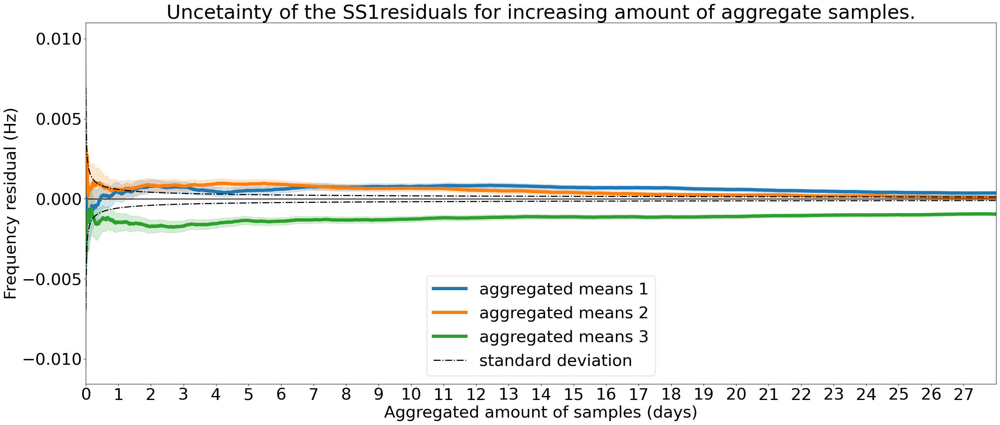

In [11]:
plt.figure(figsize=(30,12))
plt.rcParams.update({'font.size': 30})  # Set the font size to 12

days_in_plot = 28
plt.axhline(residuals.loc[:end_training].mean(), c='k')
plt.plot(means, label='aggregated means 1', linewidth=6)
plt.fill_between(range(len(means)), uncertainty_min, uncertainty_max, color='tab:blue', alpha=0.2) #, label='Uncertainty')
plt.plot(means2, label='aggregated means 2', linewidth=6)
plt.fill_between(range(len(means2)), uncertainty_min2, uncertainty_max2, color='tab:orange', alpha=0.2) #, label='Uncertainty 1 week later data')
plt.plot(means3, label='aggregated means 3', linewidth=6)
plt.fill_between(range(len(means3)), uncertainty_min3, uncertainty_max3, color='tab:green', alpha=0.2) #, label='Uncertainty 2 weeks later data')

plt.plot(stds, label='standard deviation', color = 'k', linestyle='-.', linewidth=2)
plt.plot([-x for x in stds], color = 'k', linestyle='-.', linewidth=2)

# Customizing the x-axis ticks
tick_interval = 144  # Interval between ticks
tick_locations = np.arange(0, len(stds), tick_interval)  # Generate tick locations

# Generate tick labels based on tick locations
tick_labels = [str(i // tick_interval) for i in tick_locations]

plt.xticks(tick_locations, tick_labels)  # Set the custom ticks and labels

plt.xlabel('Aggregated amount of samples (days)')
plt.ylabel('Frequency residual (Hz)')
plt.legend(loc='lower center')
plt.title('Uncetainty of the ' + mode + 'residuals for increasing amount of aggregate samples.')
#plt.grid(True, color='k', linestyle='--')
plt.xlim(0, 144*days_in_plot)
plt.show()

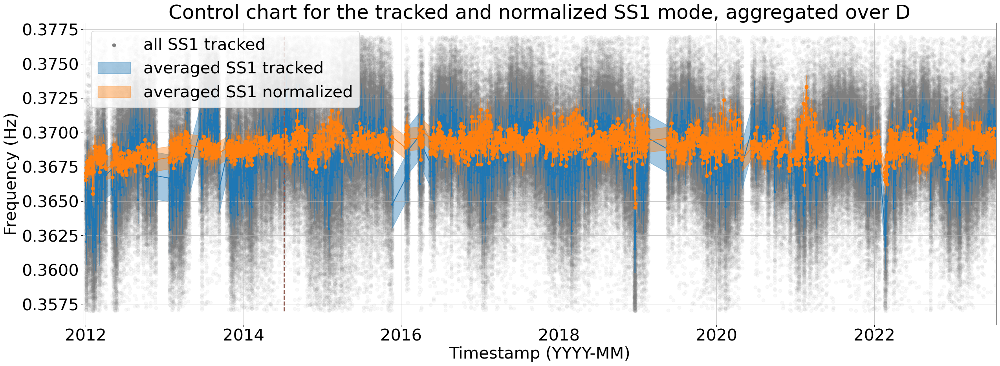

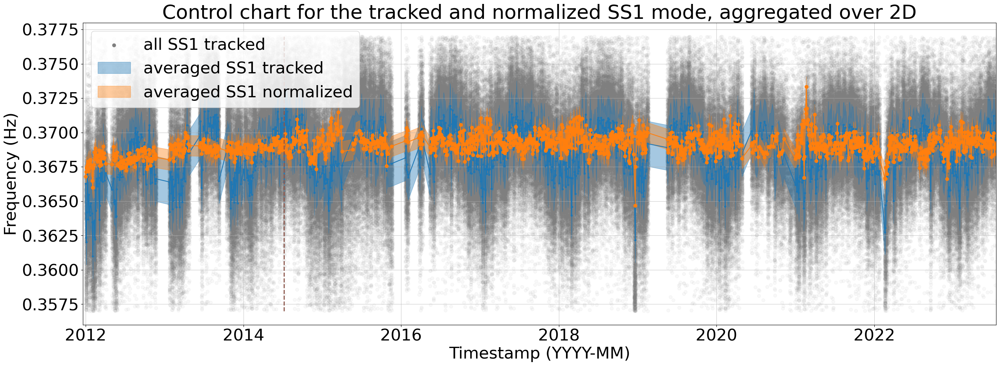

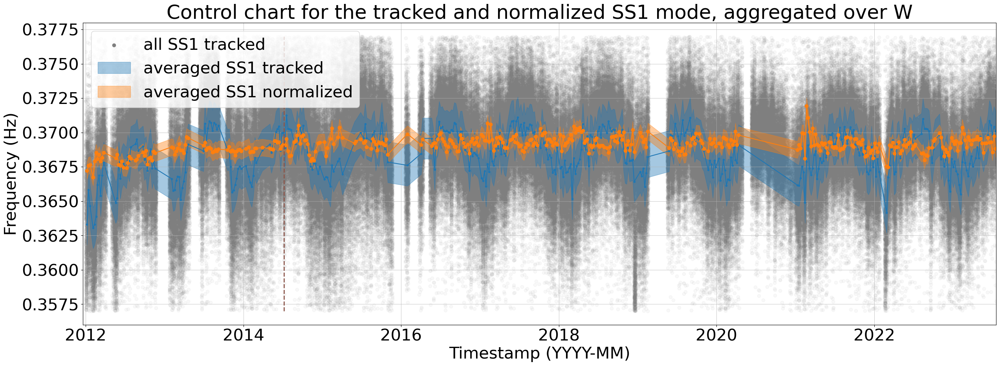

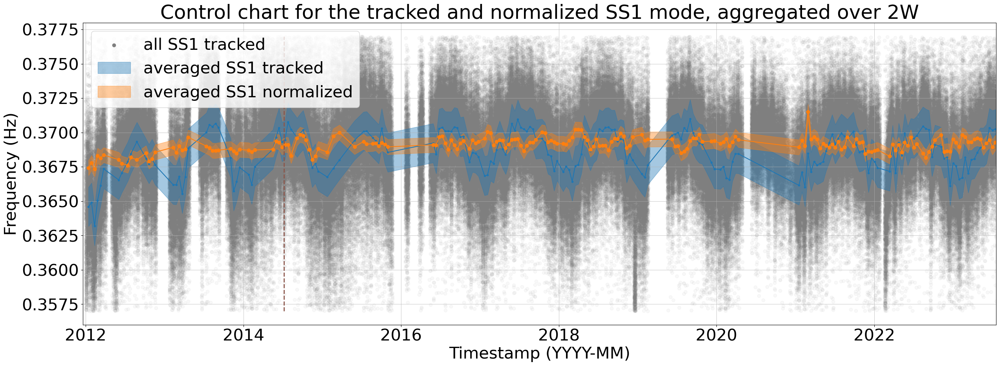

In [12]:
import warnings
from oma_tracking.scouring.scouring import aggregate_time_series
from matplotlib.collections import PathCollection
from matplotlib.legend_handler import HandlerPathCollection, HandlerLine2D

warnings.filterwarnings('ignore')
markers = ['.', 'o', 'v', '^', '<', '>', '1', '2', '3', '4', '8', 's', 'p', '*', 'h', 'H', '+', 'x', 'D', 'd', '|', '_']
timespans = ['D', '2D', 'W', '2W']

confidence = 0.99
z = stats.norm.ppf((1 + confidence) / 2)


for timespan in timespans:
        plt.figure(figsize=(30,10))
        plt.grid('--', linewidth=0.5)
        plt.title('Control chart for the tracked and normalized SS1 mode, aggregated over ' + timespan)
        m = 0
        i = 0

        
        tracked_frequencies = y.copy()
        timely_tracked_frequencies = aggregate_time_series(tracked_frequencies, timespan)
        timely_normalized_frequencies = aggregate_time_series(pd.Series(normalized, index=y.index), timespan)

        var_training = timely_tracked_frequencies.loc[:end_training].var(ddof=1)
        #std = z*np.sqrt(var_training/(len(tracked_frequencies.loc[:end_training])/len(timely_tracked_frequencies))) # std average  
        std = timely_tracked_frequencies.std()

        plt.scatter(tracked_frequencies.index, tracked_frequencies, c='tab:grey', alpha=0.05, label = 'all SS1 tracked')
        plt.plot(timely_tracked_frequencies, marker = markers[m])
        plt.fill_between(timely_tracked_frequencies.index,
                         timely_tracked_frequencies.values[:,0] - std[0],
                         timely_tracked_frequencies.values[:,0] + std[0],
                         label = 'averaged SS1 tracked',
                         color='tab:blue',
                         alpha=0.4) #, label='Confidence Interval of normalized mode')

        m += 1
        var_training = timely_normalized_frequencies.loc[:end_training].var(ddof=1)
        #std = z*np.sqrt(var_training/(len(normalized.loc[:end_training])/len(timely_normalized_frequencies))) # std average  
        std = timely_normalized_frequencies.std()
        plt.plot(timely_normalized_frequencies,  marker = markers[m])
        plt.fill_between(timely_normalized_frequencies.index,
                         timely_normalized_frequencies.values - std,
                         timely_normalized_frequencies.values + std,
                         label =  'averaged SS1 normalized',
                         color='tab:orange',
                         alpha=0.4)
        
        plt.xlabel('Timestamp (YYYY-MM)')
        plt.ylabel('Frequency (Hz)', )

        plt.vlines(end_training, tracked_frequencies.min(), tracked_frequencies.max(), color='tab:brown', linestyle='--', linewidth=2)
        #plt.text(end_training + datetime.timedelta(hours=6), 0.226 - 0.0006, 'start test data', color='tab:brown', rotation=0, fontsize=24)
        plt.xlim(tracked_frequencies.index[0] - datetime.timedelta(days=12), tracked_frequencies.index[-1])
        
        def update(handle, orig):
            handle.update_from(orig)
            handle.set_alpha(1)

        plt.legend(handler_map={PathCollection : HandlerPathCollection(update_func= update),
                                plt.Line2D : HandlerLine2D(update_func = update)}
                    ,loc='upper left')
        plt.show()

In [18]:
test_size = 0.8

prediction_param = SS1.copy()
y = prediction_param.dropna()
X = angle_transformed_inputs.loc[y.index].dropna()
y = y.loc[X.index]
X_train, X_test, y_train, y_test = \
train_test_split(X, y, test_size=test_size, shuffle=True)

In [30]:
import catboost as cb
cb_regr = cb.CatBoostRegressor(verbose=200, posterior_sampling=True,
                          loss_function='RMSEWithUncertainty')
cb_regr.fit(X, y)

0:	learn: -4.3338378	total: 101ms	remaining: 1m 40s
200:	learn: -4.5015728	total: 28.3s	remaining: 1m 52s
400:	learn: -4.5125696	total: 55.1s	remaining: 1m 22s
600:	learn: -4.5170363	total: 1m 34s	remaining: 1m 2s
800:	learn: -4.5204966	total: 2m 2s	remaining: 30.4s
999:	learn: -4.5232072	total: 2m 26s	remaining: 0us


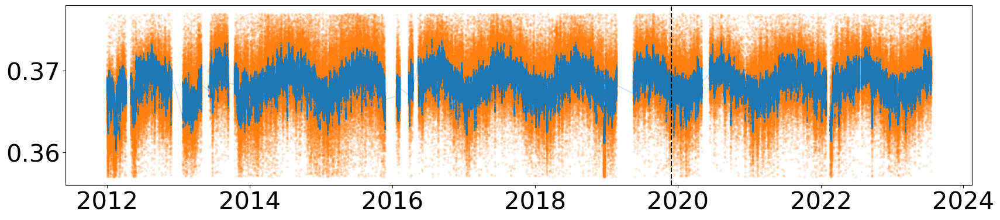

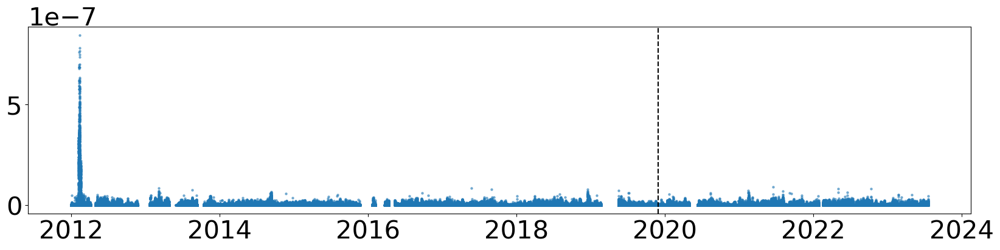

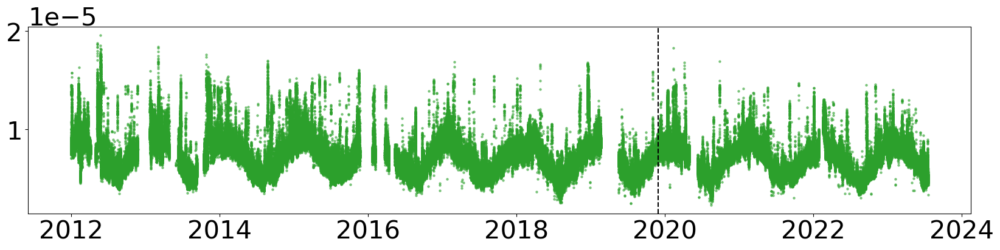

In [31]:
preds = cb_regr.virtual_ensembles_predict(X, prediction_type='TotalUncertainty', 
                                        virtual_ensembles_count=100)

mean_preds = preds[:,0] # mean values predicted by a virtual ensemble
knowledge = preds[:,1] # knowledge uncertainty predicted by a virtual ensemble
data = preds[:,2] # average estimated data uncertainty

plt.figure(figsize=(20,4))
plt.scatter(y.index, y, alpha=0.1, color='tab:orange', s=5)
plt.scatter(y.index, mean_preds, alpha=0.5, color='tab:blue', s=1)
plt.fill_between(y.index, mean_preds-knowledge, mean_preds+knowledge, alpha = 0.2, color = 'tab:blue')
plt.axvline(x=X_test.index[0], color='k', linestyle='--')
plt.show()

plt.figure(figsize=(20,4))
plt.scatter(y.index, knowledge, alpha=0.5, color='tab:blue',s=5)
plt.axvline(x=X_test.index[0], color='k', linestyle='--')
plt.show()

plt.figure(figsize=(20,4))
plt.scatter(y.index, data, alpha=0.5, color='tab:green',s=5)
plt.axvline(x=X_test.index[0], color='k', linestyle='--')
plt.show()

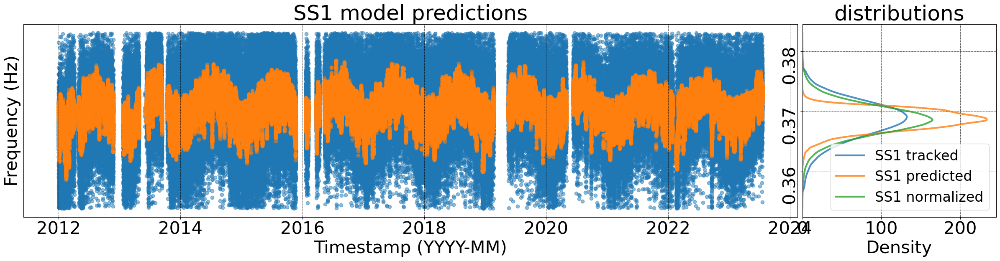

In [32]:
import numpy as np 
import matplotlib.gridspec as gridspec
import seaborn as sns
mode = 'SS1'

# Create a grid of subplots
fig, axs = plt.subplots(1, 2, figsize=(30, 6))
grid = gridspec.GridSpec(1, 2, width_ratios=[8, 2])
ax1 = plt.subplot(grid[0])
ax1.scatter(y.index, y, label = 'SS1 tracked', alpha = 0.5)
ax1.scatter(y.index, mean_preds, label = 'SS1 predicted', alpha=0.5)
ax1.set_ylabel('Frequency (Hz)')
ax1.set_xlabel('Timestamp (YYYY-MM)')
ax1.set_title(mode + ' model predictions')
ax1.set_yticks([])
ax1.grid(True, color='k', linestyle='--', linewidth=0.5)

ax2 = plt.subplot(grid[1])
ax2.set_title('distributions')
sns.kdeplot(y.values[:,0], label='SS1 tracked', ax=ax2, alpha=0.8, vertical=True, linewidth=3)
sns.kdeplot(mean_preds, label='SS1 predicted', ax=ax2, alpha=0.8, vertical=True, linewidth=3)
normalized = (y.values[:,0]-mean_preds) + np.mean(y.values[:,0])
sns.kdeplot(normalized, label='SS1 normalized', ax=ax2, alpha=0.8, vertical=True, linewidth=3)

# Rotate the y-axis labels of the KDE plot
for tick in ax2.get_yticklabels():
    tick.set_rotation(90)

ax2.grid(True, color='k', linestyle='--', linewidth=0.5)
# Adjust the spacing between subplots
plt.subplots_adjust(wspace=0.01)
legend = plt.legend()
legend.set_alpha(1.0)  # Remove alpha from the legend
# Remove alpha from the legend items
for text in legend.get_texts():
    text.set_alpha(1.0)
plt.legend(fontsize=24)
plt.show()

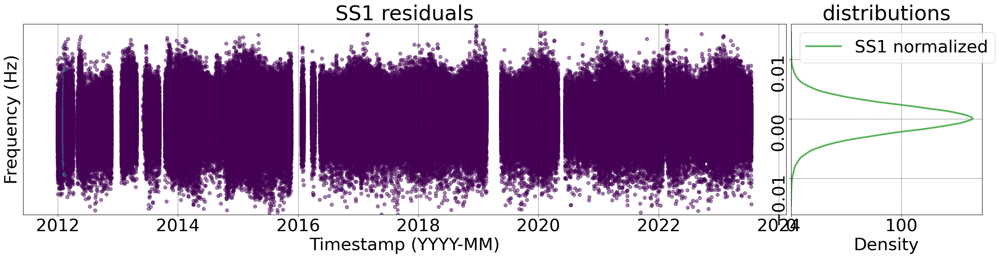

In [35]:
import matplotlib
residuals = pd.Series(y.values[:,0] - mean_preds, index=y.index)

# Create a grid of subplots
fig, axs = plt.subplots(1, 2, figsize=(30, 6))
grid = gridspec.GridSpec(1, 2, width_ratios=[8, 2])
ax1 = plt.subplot(grid[0])
ax1.scatter(residuals.index, residuals, label = 'SS1 residuals', alpha=0.5, c=knowledge)

ax1.set_ylabel('Frequency (Hz)')
ax1.set_title(mode + ' residuals')
ax1.set_yticks([])
ax1.grid(True, color='k', linestyle='--', linewidth=0.5)
ax1.set_ylim(residuals.min(), residuals.max())
ax1.set_xlabel('Timestamp (YYYY-MM)')

ax2 = plt.subplot(grid[1])
ax2.set_title('distributions')
sns.kdeplot(residuals.values, label='SS1 normalized', ax=ax2, alpha=0.8, vertical=True, color='tab:green', linewidth=3)
ax2.grid(True, color='k', linestyle='--', linewidth=0.5)

# Rotate the y-axis labels of the KDE plot
for tick in ax2.get_yticklabels():
    tick.set_rotation(90)

# Adjust the spacing between subplots
plt.subplots_adjust(wspace=0.01)
legend = plt.legend()
# Remove alpha from the legend items
for text in legend.get_texts():
    text.set_alpha(1.0)
plt.legend()
plt.show()

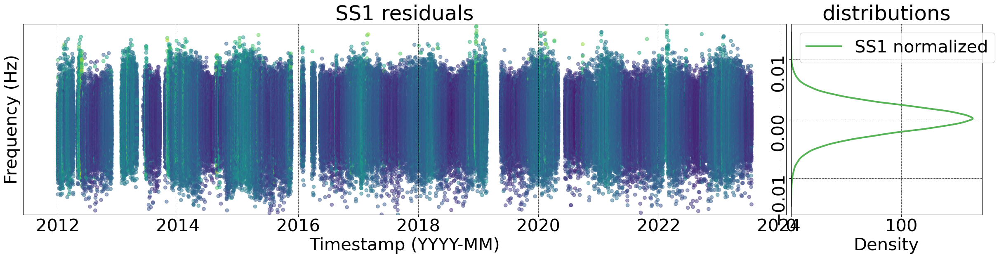

In [36]:
residuals = pd.Series(y.values[:,0] - mean_preds, index=y.index)

# Create a grid of subplots
fig, axs = plt.subplots(1, 2, figsize=(30, 6))
grid = gridspec.GridSpec(1, 2, width_ratios=[8, 2])
ax1 = plt.subplot(grid[0])
ax1.scatter(residuals.index, residuals, label = 'SS1 residuals', alpha=0.5, c=data)

ax1.set_ylabel('Frequency (Hz)')
ax1.set_title(mode + ' residuals')
ax1.set_yticks([])
ax1.grid(True, color='k', linestyle='--', linewidth=0.5)
ax1.set_ylim(residuals.min(), residuals.max())
ax1.set_xlabel('Timestamp (YYYY-MM)')

ax2 = plt.subplot(grid[1])
ax2.set_title('distributions')
sns.kdeplot(residuals.values, label='SS1 normalized', ax=ax2, alpha=0.8, vertical=True, color='tab:green', linewidth=3)
ax2.grid(True, color='k', linestyle='--', linewidth=0.5)

# Rotate the y-axis labels of the KDE plot
for tick in ax2.get_yticklabels():
    tick.set_rotation(90)

# Adjust the spacing between subplots
plt.subplots_adjust(wspace=0.01)
legend = plt.legend()
# Remove alpha from the legend items
for text in legend.get_texts():
    text.set_alpha(1.0)
plt.legend()
plt.show()

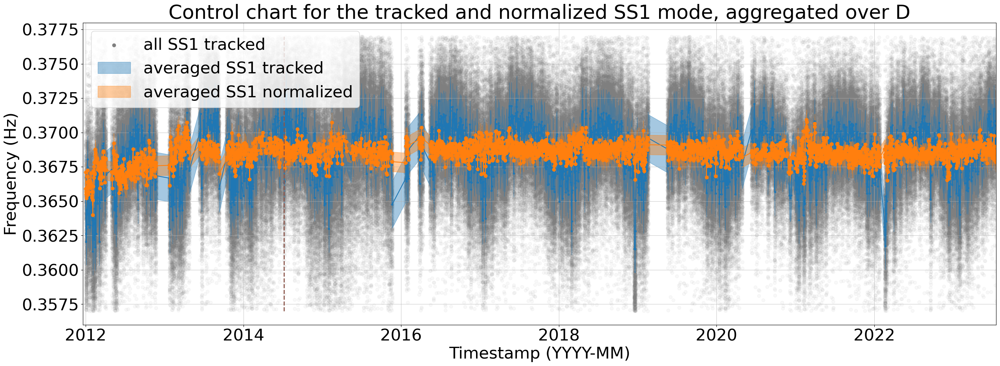

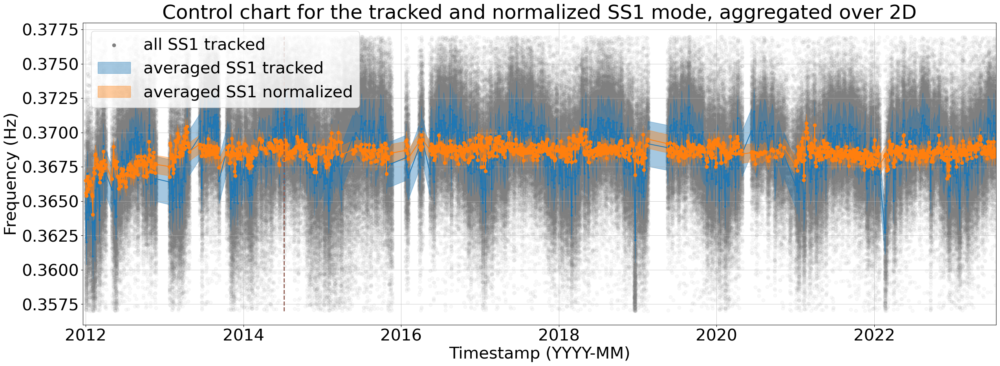

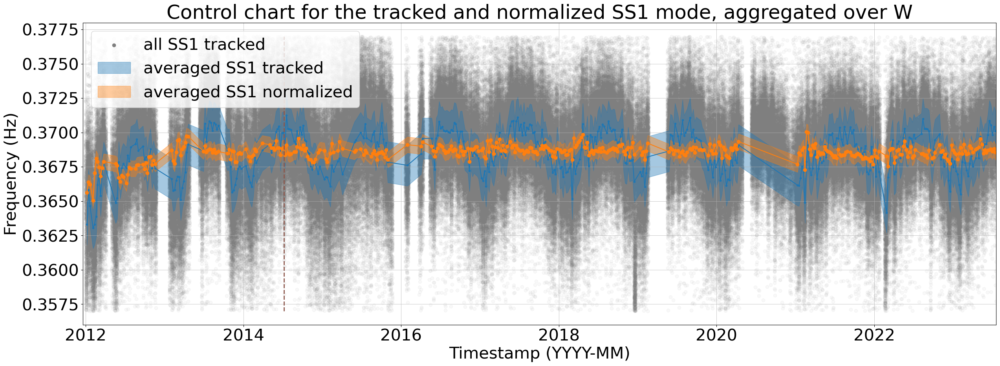

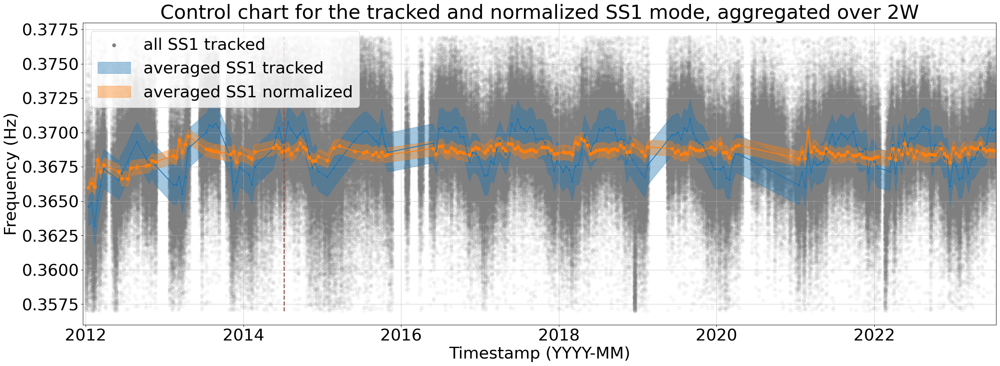

In [37]:
import warnings
from oma_tracking.scouring.scouring import aggregate_time_series
from matplotlib.collections import PathCollection
from matplotlib.legend_handler import HandlerPathCollection, HandlerLine2D

warnings.filterwarnings('ignore')
markers = ['.', 'o', 'v', '^', '<', '>', '1', '2', '3', '4', '8', 's', 'p', '*', 'h', 'H', '+', 'x', 'D', 'd', '|', '_']
timespans = ['D', '2D', 'W', '2W']

confidence = 0.99
z = stats.norm.ppf((1 + confidence) / 2)

normalized = (y.values[:,0]-mean_preds) + np.mean(y.values[:,0])


for timespan in timespans:
        plt.figure(figsize=(30,10))
        plt.grid('--', linewidth=0.5)
        plt.title('Control chart for the tracked and normalized SS1 mode, aggregated over ' + timespan)
        m = 0
        i = 0

        
        tracked_frequencies = y.copy()
        timely_tracked_frequencies = aggregate_time_series(tracked_frequencies, timespan)
        timely_normalized_frequencies = aggregate_time_series(pd.Series(normalized, index=y.index), timespan)

        var_training = timely_tracked_frequencies.loc[:end_training].var(ddof=1)
        #std = z*np.sqrt(var_training/(len(tracked_frequencies.loc[:end_training])/len(timely_tracked_frequencies))) # std average  
        std = timely_tracked_frequencies.std()

        plt.scatter(tracked_frequencies.index, tracked_frequencies, c='tab:grey', alpha=0.05, label = 'all SS1 tracked')
        plt.plot(timely_tracked_frequencies, marker = markers[m])
        plt.fill_between(timely_tracked_frequencies.index,
                         timely_tracked_frequencies.values[:,0] - std[0],
                         timely_tracked_frequencies.values[:,0] + std[0],
                         label = 'averaged SS1 tracked',
                         color='tab:blue',
                         alpha=0.4) #, label='Confidence Interval of normalized mode')

        m += 1
        var_training = timely_normalized_frequencies.loc[:end_training].var(ddof=1)
        #std = z*np.sqrt(var_training/(len(normalized.loc[:end_training])/len(timely_normalized_frequencies))) # std average  
        std = timely_normalized_frequencies.std()
        plt.plot(timely_normalized_frequencies,  marker = markers[m])
        plt.fill_between(timely_normalized_frequencies.index,
                         timely_normalized_frequencies.values - std,
                         timely_normalized_frequencies.values + std,
                         label =  'averaged SS1 normalized',
                         color='tab:orange',
                         alpha=0.4)
        
        plt.xlabel('Timestamp (YYYY-MM)')
        plt.ylabel('Frequency (Hz)', )

        plt.vlines(end_training, tracked_frequencies.min(), tracked_frequencies.max(), color='tab:brown', linestyle='--', linewidth=2)
        #plt.text(end_training + datetime.timedelta(hours=6), 0.226 - 0.0006, 'start test data', color='tab:brown', rotation=0, fontsize=24)
        plt.xlim(tracked_frequencies.index[0] - datetime.timedelta(days=12), tracked_frequencies.index[-1])
        
        def update(handle, orig):
            handle.update_from(orig)
            handle.set_alpha(1)

        plt.legend(handler_map={PathCollection : HandlerPathCollection(update_func= update),
                                plt.Line2D : HandlerLine2D(update_func = update)}
                    ,loc='upper left')
        plt.show()